<img src="../../docs/images/dlsia.png" width=600 />

# Ensemble Learning with Randomized Sparse Mixed-Scale Networks

Authors: Eric Roberts and Petrus Zwart

E-mail: PHZwart@lbl.gov, EJRoberts@lbl.gov
___

This notebook highlights some basic functionality with the pyMSDtorch package.
 
We will train 13 different randomized sparse mixed-scale networks (SMSNets) to perform binary segmentation of retinal vessels on the [Structured Analysis of the Retina (STARE) dataset](https://ieeexplore.ieee.org/stamp/stamp.jsp?arnumber=845178&casa_token=G-hRLLwrHrcAAAAA:t8htUdrSm0gZlAPxjYdwDKkW2RJyWonfHeA2YPAUC76INDlBhzlMsQPXCF0VVsUpXLjNKmw91Q&tag=1). 

After training, we combine the best performing networks into a single estimator and return both the mean and standard deviation of the estimated class probabilities. We subsequently use [conformal estimation](https://arxiv.org/pdf/2107.07511.pdf) to get calibrated conformal sets that are guaranteed to contain the right label, with user-specified probability.
___

## Imports and helper functions

In [1]:
import numpy as np
import pandas as pd
import math
import torch
import torch.nn as nn
from torch.nn import functional
import torch.optim as optim
from torch.utils.data import TensorDataset

import torchvision
from torchvision import transforms

from pdlsia.core import helpers
from dlsia.core import train_scripts
from dlsia.core.networks import smsnet
from dlsia.core.networks import baggins
from dlsia.core.conformalize import conformalize_segmentation
from dlsia.viz_tools import plots
from dlsia.viz_tools import draw_sparse_network

import matplotlib.pyplot as plt

import pickle
import gc
import einops
import os

In [2]:
# we need to unzip images
import gzip, shutil, fnmatch
def gunzip(file_path,output_path):
    with gzip.open(file_path,"rb") as f_in, open(output_path,"wb") as f_out:
        shutil.copyfileobj(f_in, f_out)
        os.remove(file_path)

def unzip_directory(directory):
    walker = os.walk(directory)
    for directory,dirs,files in walker:
        for f in files:
            if fnmatch.fnmatch(f,"*.gz"):
                gunzip(directory+f,directory+f.replace(".gz",""))

## Download and view data

First, we need to download the STARE data, a dataset for semantic segmentation of retinal blood vessel commonly used as a benchmark. 

All data will be stored in a freshly created directory titled ```tmpSTARE_DATA```

In [3]:
import requests, tarfile

# make directories
path_to_data = "/tmp/"
if not os.path.isdir(path_to_data+'STARE_DATA'):
    os.mkdir(path_to_data+'STARE_DATA')
    os.mkdir(path_to_data+'STARE_DATA/images')
    os.mkdir(path_to_data+'STARE_DATA/labels')

    # get the data first
    url = 'https://cecas.clemson.edu/~ahoover/stare/probing/stare-images.tar'
    r = requests.get(url, allow_redirects=True)
    tmp = open(path_to_data+'STARE_DATA/stare-vessels.tar', 'wb').write(r.content)
    my_tar = tarfile.open(path_to_data+'STARE_DATA/stare-vessels.tar')
    my_tar.extractall(path_to_data+'STARE_DATA/images/')
    my_tar.close()

    unzip_directory(path_to_data+'STARE_DATA/images/')


    # get the ah-labels
    url = 'https://cecas.clemson.edu/~ahoover/stare/probing/labels-ah.tar'
    r = requests.get(url, allow_redirects=True)
    tmp = open(path_to_data+'STARE_DATA/labels-ah.tar', 'wb').write(r.content)
    my_tar = tarfile.open(path_to_data+'STARE_DATA/labels-ah.tar')
    my_tar.extractall(path_to_data+'STARE_DATA/labels/')
    my_tar.close()
    unzip_directory(path_to_data+'STARE_DATA/labels/')

### Transform data

Here we cast all images from numpy arrays to pytorch tensors and prep data for training

In [4]:
dataset = torchvision.datasets.ImageFolder(path_to_data+"STARE_DATA/", transform=transforms.ToTensor())
images = [np.array(dataset[i][0].permute(1,2,0)) for i in range(len(dataset)) if dataset[i][1] == 0]        
images = torch.stack([torch.Tensor(image).permute(2, 0, 1) for image in images])
labels = torch.stack([dataset[i][0] for i in range(len(dataset)) if dataset[i][1] == 1])
labels = torch.sum(labels, dim=1)
labels = torch.unsqueeze(labels, 1)
labels = torch.where(labels != 0, 1, 0)
#make if divisional friendly
images = images[:,:,:600,:]
labels = labels[:,:,:600,:]

downsample_factor=2
images = functional.interpolate(images, 
                                size=(images.shape[-2]//downsample_factor, 
                                      images.shape[-1]//downsample_factor), 
                                mode="bilinear")
labels = functional.interpolate(labels.type(torch.FloatTensor), 
                                size=(labels.shape[-2]//downsample_factor, 
                                      labels.shape[-1]//downsample_factor), 
                                mode="nearest")
all_ds = TensorDataset(images,labels)
test_ds = TensorDataset(images[0:2],labels[0:2].type(torch.LongTensor))
val_ds = TensorDataset(images[2:3],labels[2:3].type(torch.LongTensor))
train_ds = TensorDataset(images[3:],labels[3:].type(torch.LongTensor))


print("Size of train dataset:", len(train_ds))
print("Size of validation dataset:", len(val_ds))
print("Size of test dataset:", len(test_ds))

Size of train dataset: 17
Size of validation dataset: 1
Size of test dataset: 2


### View data


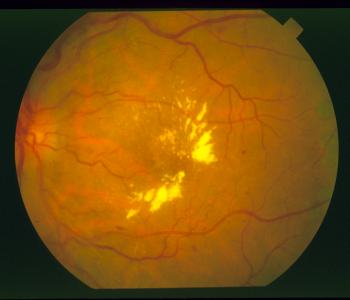

In [5]:
params = {}
params["title"]="Image and Labels"
img = images[0].permute(1,2,0)
lbl = labels[0][0]
fig = plots.plot_rgb_and_labels(img.numpy(), lbl.numpy(), params)
fig.update_layout(width=700)
#plt.tight_layout()
fig.show()


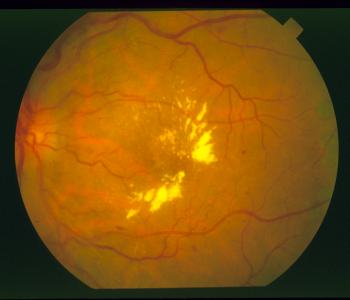

<Figure size 432x288 with 0 Axes>

In [6]:
params = {}
params["title"]="Image and Labels"
img = images[0].permute(1,2,0)
lbl = labels[0][0]
fig = plots.plot_rgb_and_labels(img.numpy(), lbl.numpy(), params)
fig.update_layout(width=700)

plt.tight_layout()
fig.show()

### Dataloader class

We make liberal use of the PyTorch Dataloader class for easy handling and iterative loading of data into the networks and models. 

With the chosen batch_size of 2, training requires roughly 4.5 to 6.0 GBs of GPU memory. Please note, memory comsumption is not static as network connectivity/sparsity is not static.

In [7]:
# create data loaders
num_workers = 0   

train_loader_params = {'batch_size': 2, 
                 'shuffle': True,
                 'num_workers': num_workers, 
                 'pin_memory':False,
                 'drop_last': False}

test_loader_params = {'batch_size': len(test_ds), 
                 'shuffle': False,
                 'num_workers': num_workers, 
                 'pin_memory':False,
                 'drop_last': False}

train_loader = torch.utils.data.DataLoader(train_ds, **train_loader_params)
val_loader = torch.utils.data.DataLoader(val_ds, **train_loader_params)
test_loader = torch.utils.data.DataLoader(test_ds, **test_loader_params)

print(train_ds.tensors[0].shape)

torch.Size([17, 3, 300, 350])


## Create random sparse networks

Define SMSNet (Sparse Mixed-Scale Network) architecture-governing hyperparameters here. 

### Specify hyperparameters

First, each random network will have the same number of layers/nodes. These hyperparameters dicate the layout, or topology, of all networks.

In [8]:
in_channels = 3 # RGB input image
out_channels = 2 # binary output

# we will use 15 hidden layers (typical MSDNets are >50)
num_layers = 15 

Next, the hyperparameters below govern the random network connectivity. Choices include: 

- alpha -- modifies distribution of consecutive connection length between network layers/nodes,
- gamma -- modifies distribution of of layer/node degree,
- IL -- probability of connection between Input node and Layer node, 
- IO -- probability of connection between Input node and Output node,
- LO -- probability of connection between Layer node and Output node,
- dilation_choices --  set of possible dilations along each individual node connection


The specific parameters and what they do are described in detail in the documentation. Please follow minor  minor comments below for a more cursory explanation.

In [9]:
# When alpha > 0, short-range skip connections are favoured
alpha = 0.50 

# When gamma is 0, the degree of each node is chosen uniformly between 0 and max_k
# specifically, P(degree) \propto degree^-gamma
gamma = 0.0

# we can limit the maximum and minimum degree of our graph 
max_k = 5 
min_k = 3

# features channel posibilities per edge
hidden_out_channels = [10] 

# possible dilation choices
dilation_choices = [1,2,3,4,8,16] 

# Here are some parameters that define how networks are drawn at random
# the layer probabilities dictionairy define connections
layer_probabilities={'LL_alpha':alpha,
                     'LL_gamma': gamma,
                     'LL_max_degree':max_k,
                     'LL_min_degree':min_k,
                     'IL': 0.25,
                     'LO': 0.25,
                     'IO': True}

# if desired, one can introduce scale changes (down and upsample)
# a not-so-thorough look indicates that this isn't really super beneficial
# in the model systems we looked at
sizing_settings = {'stride_base':2, #better keep this at 2
                   'min_power': 0,
                   'max_power': 0}

# defines the type of network we want to build
network_type = "Classification"



## Build networks and train

We specify the number of random networks to initialize and the number of epochs for each is trained.

In [10]:
# build the networks
nets = []          # we want to store a number of them
performance = []   # and keep track of how well they do
N_networks = 7     # number of random networks to create
epochs = 100       # set number of training epochs


### Training loop

Now we cycle through each individual network and train.

Network 1


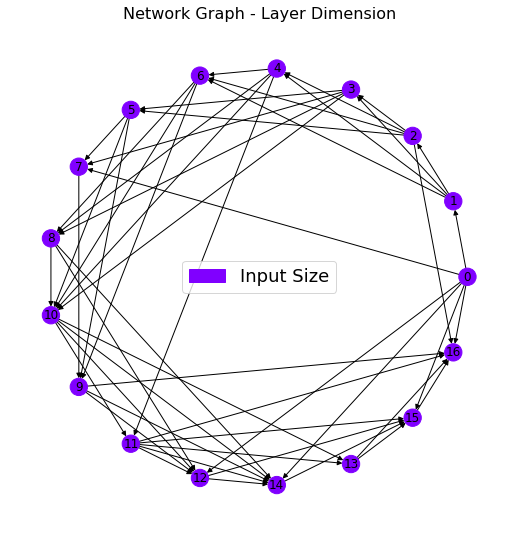

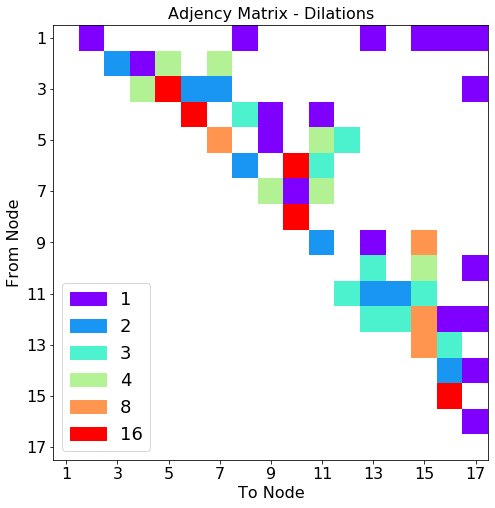

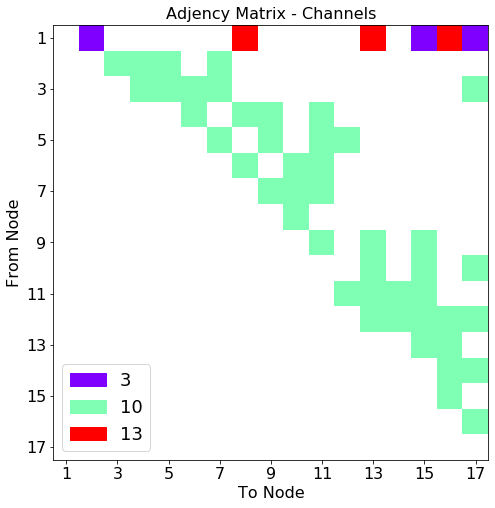

Start training
Total number of refineable parameters:  93142
Epoch 10 of 100 | Learning rate 1.000e-03
   Training Loss: 1.5782e-01 | Validation Loss: 2.0355e-01
   Micro Training F1: 0.9554 | Micro Validation F1: 0.9441
   Macro Training F1: 0.8407 | Macro Validation F1: 0.7878
Epoch 20 of 100 | Learning rate 1.000e-03
   Training Loss: 1.1057e-01 | Validation Loss: 1.4875e-01
   Micro Training F1: 0.9674 | Micro Validation F1: 0.9567
   Macro Training F1: 0.8885 | Macro Validation F1: 0.8471
Epoch 30 of 100 | Learning rate 1.000e-03
   Training Loss: 9.3169e-02 | Validation Loss: 1.4880e-01
   Micro Training F1: 0.9712 | Micro Validation F1: 0.9602
   Macro Training F1: 0.9030 | Macro Validation F1: 0.8555
Epoch 40 of 100 | Learning rate 1.000e-03
   Training Loss: 8.1003e-02 | Validation Loss: 1.4620e-01
   Micro Training F1: 0.9741 | Micro Validation F1: 0.9606
   Macro Training F1: 0.9105 | Macro Validation F1: 0.8579
Epoch 50 of 100 | Learning rate 1.000e-03
   Training Loss: 7.1

Network 2


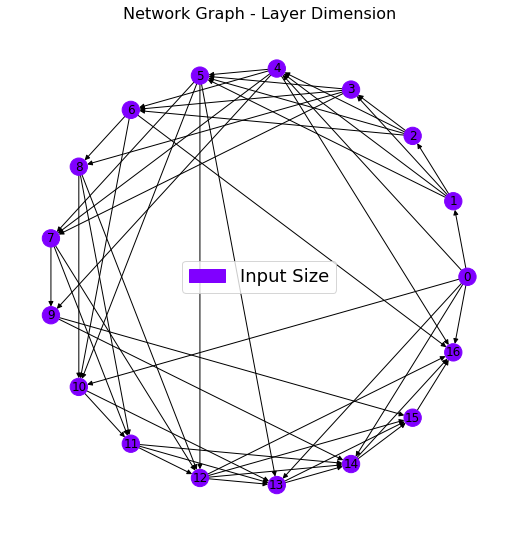

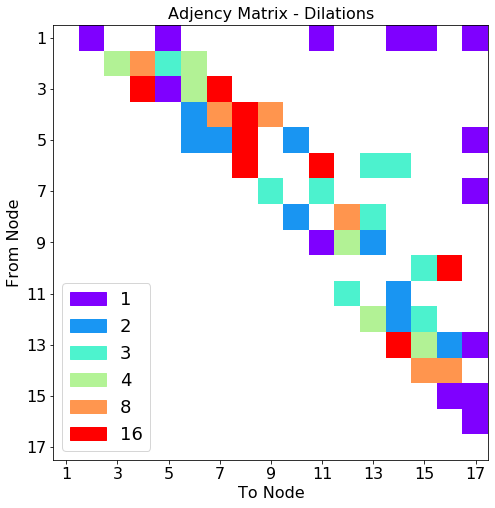

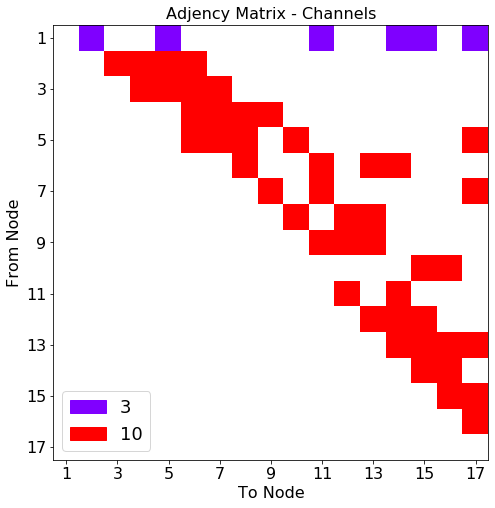

Start training
Total number of refineable parameters:  96662
Epoch 10 of 100 | Learning rate 1.000e-03
   Training Loss: 1.5478e-01 | Validation Loss: 1.9002e-01
   Micro Training F1: 0.9563 | Micro Validation F1: 0.9434
   Macro Training F1: 0.8478 | Macro Validation F1: 0.7989
Epoch 20 of 100 | Learning rate 1.000e-03
   Training Loss: 1.1861e-01 | Validation Loss: 1.6209e-01
   Micro Training F1: 0.9648 | Micro Validation F1: 0.9536
   Macro Training F1: 0.8808 | Macro Validation F1: 0.8314
Epoch 30 of 100 | Learning rate 1.000e-03
   Training Loss: 9.4062e-02 | Validation Loss: 1.5499e-01
   Micro Training F1: 0.9715 | Micro Validation F1: 0.9544
   Macro Training F1: 0.9026 | Macro Validation F1: 0.8386
Epoch 40 of 100 | Learning rate 1.000e-03
   Training Loss: 8.0209e-02 | Validation Loss: 1.4227e-01
   Micro Training F1: 0.9758 | Micro Validation F1: 0.9582
   Macro Training F1: 0.9171 | Macro Validation F1: 0.8557
Epoch 50 of 100 | Learning rate 1.000e-03
   Training Loss: 7.1

Network 3


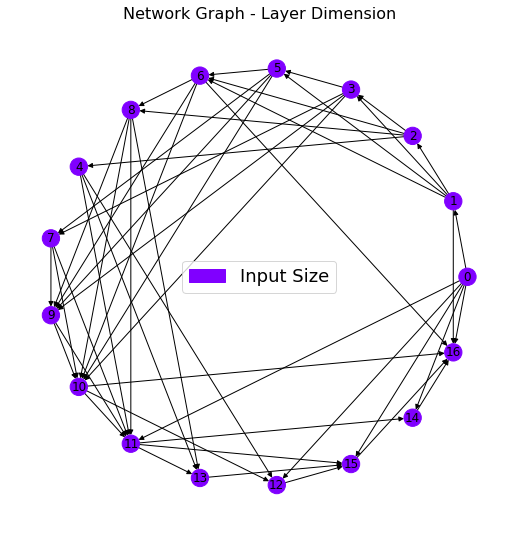

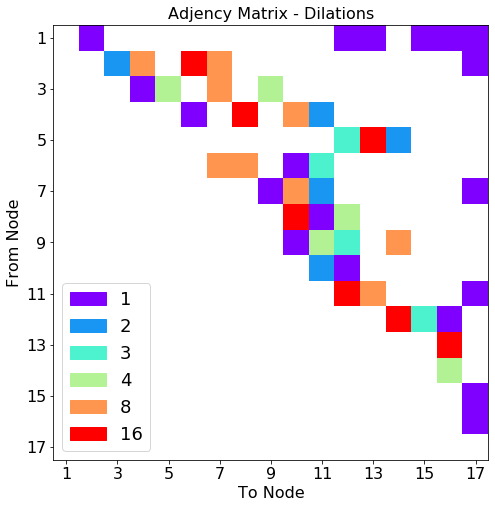

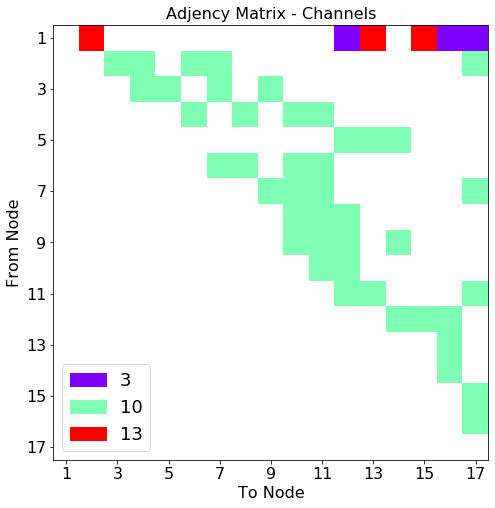

Start training
Total number of refineable parameters:  88842
Epoch 10 of 100 | Learning rate 1.000e-03
   Training Loss: 1.5973e-01 | Validation Loss: 1.8774e-01
   Micro Training F1: 0.9553 | Micro Validation F1: 0.9480
   Macro Training F1: 0.8457 | Macro Validation F1: 0.8043
Epoch 20 of 100 | Learning rate 1.000e-03
   Training Loss: 1.2663e-01 | Validation Loss: 1.6645e-01
   Micro Training F1: 0.9623 | Micro Validation F1: 0.9534
   Macro Training F1: 0.8723 | Macro Validation F1: 0.8274
Epoch 30 of 100 | Learning rate 1.000e-03
   Training Loss: 9.6363e-02 | Validation Loss: 1.6022e-01
   Micro Training F1: 0.9699 | Micro Validation F1: 0.9560
   Macro Training F1: 0.8959 | Macro Validation F1: 0.8402
Epoch 40 of 100 | Learning rate 1.000e-03
   Training Loss: 8.4787e-02 | Validation Loss: 1.4799e-01
   Micro Training F1: 0.9736 | Micro Validation F1: 0.9578
   Macro Training F1: 0.9102 | Macro Validation F1: 0.8507
Epoch 50 of 100 | Learning rate 1.000e-03
   Training Loss: 7.9

Network 4


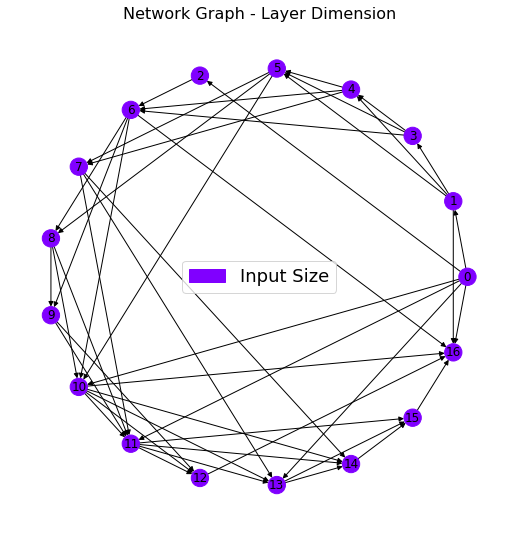

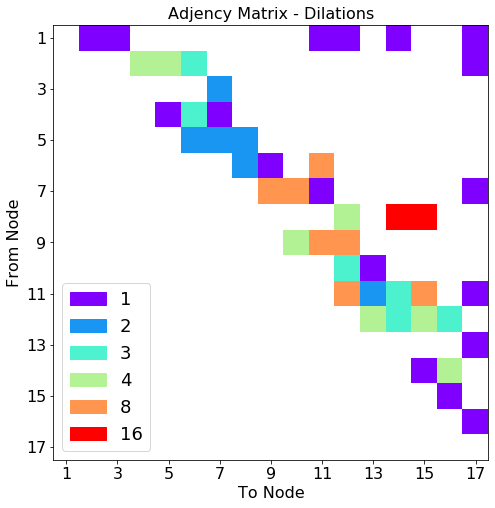

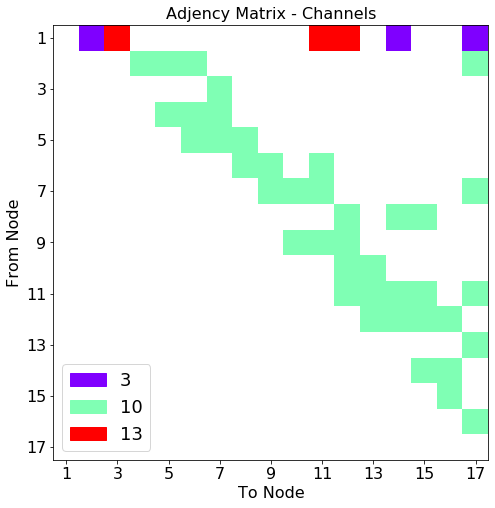

Start training
Total number of refineable parameters:  87442
Epoch 10 of 100 | Learning rate 1.000e-03
   Training Loss: 1.5691e-01 | Validation Loss: 1.7324e-01
   Micro Training F1: 0.9563 | Micro Validation F1: 0.9515
   Macro Training F1: 0.8480 | Macro Validation F1: 0.8234
Epoch 20 of 100 | Learning rate 1.000e-03
   Training Loss: 1.2674e-01 | Validation Loss: 1.6609e-01
   Micro Training F1: 0.9632 | Micro Validation F1: 0.9470
   Macro Training F1: 0.8748 | Macro Validation F1: 0.8227
Epoch 30 of 100 | Learning rate 1.000e-03
   Training Loss: 1.0880e-01 | Validation Loss: 1.5844e-01
   Micro Training F1: 0.9671 | Micro Validation F1: 0.9527
   Macro Training F1: 0.8849 | Macro Validation F1: 0.8374
Epoch 40 of 100 | Learning rate 1.000e-03
   Training Loss: 9.2915e-02 | Validation Loss: 1.5283e-01
   Micro Training F1: 0.9714 | Micro Validation F1: 0.9541
   Macro Training F1: 0.9034 | Macro Validation F1: 0.8428
Epoch 50 of 100 | Learning rate 1.000e-03
   Training Loss: 8.8

Network 5


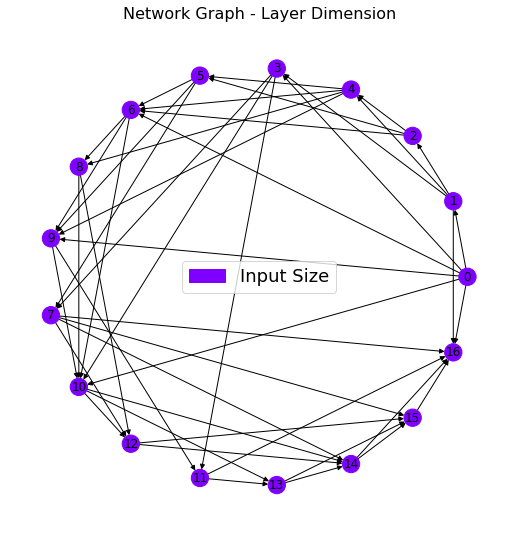

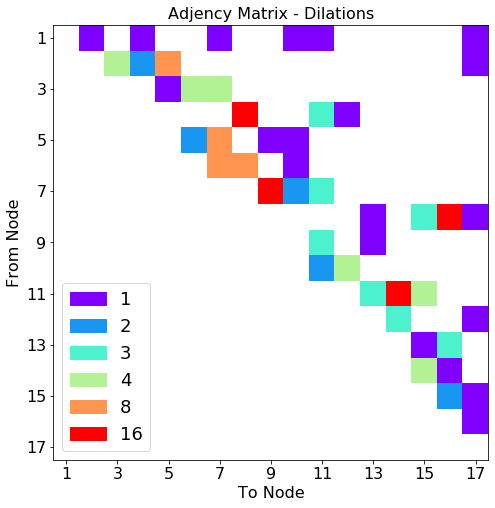

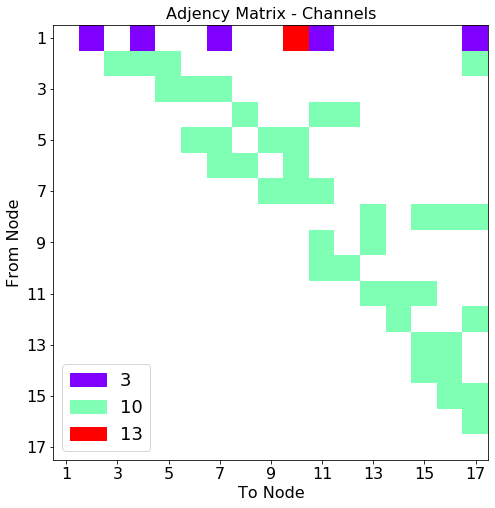

Start training
Total number of refineable parameters:  73752
Epoch 10 of 100 | Learning rate 1.000e-03
   Training Loss: 1.5689e-01 | Validation Loss: 1.9027e-01
   Micro Training F1: 0.9574 | Micro Validation F1: 0.9404
   Macro Training F1: 0.8445 | Macro Validation F1: 0.7981
Epoch 20 of 100 | Learning rate 1.000e-03
   Training Loss: 1.1690e-01 | Validation Loss: 1.6492e-01
   Micro Training F1: 0.9658 | Micro Validation F1: 0.9443
   Macro Training F1: 0.8815 | Macro Validation F1: 0.8215
Epoch 30 of 100 | Learning rate 1.000e-03
   Training Loss: 9.8796e-02 | Validation Loss: 1.5999e-01
   Micro Training F1: 0.9713 | Micro Validation F1: 0.9489
   Macro Training F1: 0.9003 | Macro Validation F1: 0.8333
Epoch 40 of 100 | Learning rate 1.000e-03
   Training Loss: 8.6053e-02 | Validation Loss: 1.3982e-01
   Micro Training F1: 0.9730 | Micro Validation F1: 0.9589
   Macro Training F1: 0.9094 | Macro Validation F1: 0.8571
Epoch 50 of 100 | Learning rate 1.000e-03
   Training Loss: 7.7

Network 6


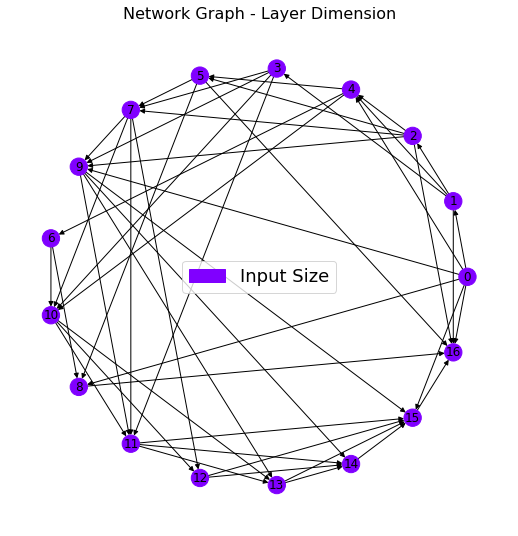

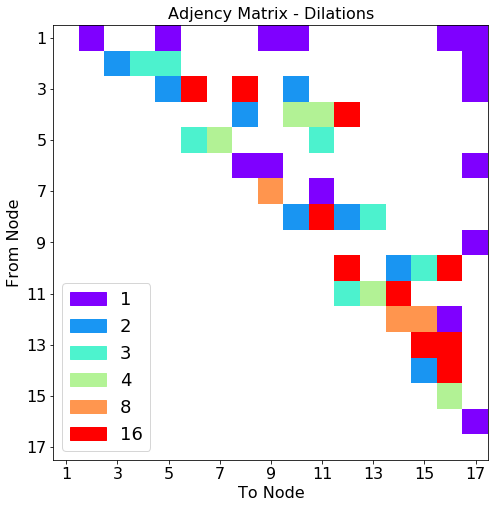

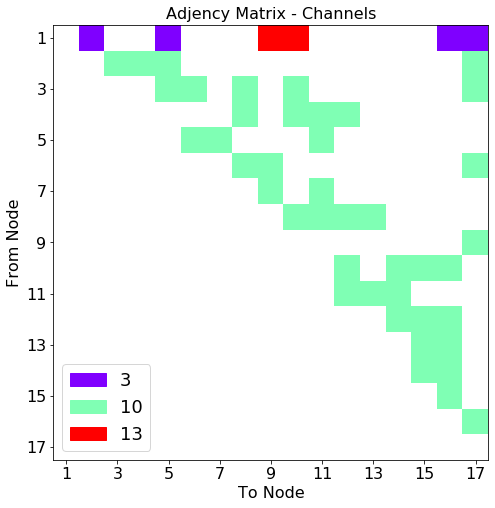

Start training
Total number of refineable parameters:  82622
Epoch 10 of 100 | Learning rate 1.000e-03
   Training Loss: 1.4776e-01 | Validation Loss: 1.8072e-01
   Micro Training F1: 0.9581 | Micro Validation F1: 0.9484
   Macro Training F1: 0.8570 | Macro Validation F1: 0.8110
Epoch 20 of 100 | Learning rate 1.000e-03
   Training Loss: 1.0722e-01 | Validation Loss: 1.4885e-01
   Micro Training F1: 0.9677 | Micro Validation F1: 0.9569
   Macro Training F1: 0.8896 | Macro Validation F1: 0.8490
Epoch 30 of 100 | Learning rate 1.000e-03
   Training Loss: 9.1875e-02 | Validation Loss: 1.4276e-01
   Micro Training F1: 0.9722 | Micro Validation F1: 0.9589
   Macro Training F1: 0.9052 | Macro Validation F1: 0.8535
Epoch 40 of 100 | Learning rate 1.000e-03
   Training Loss: 7.7978e-02 | Validation Loss: 1.5321e-01
   Micro Training F1: 0.9757 | Micro Validation F1: 0.9557
   Macro Training F1: 0.9180 | Macro Validation F1: 0.8474
Epoch 50 of 100 | Learning rate 1.000e-03
   Training Loss: 6.9

Network 7


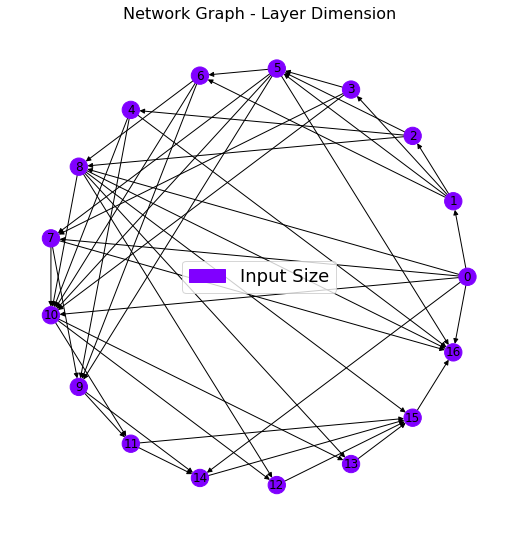

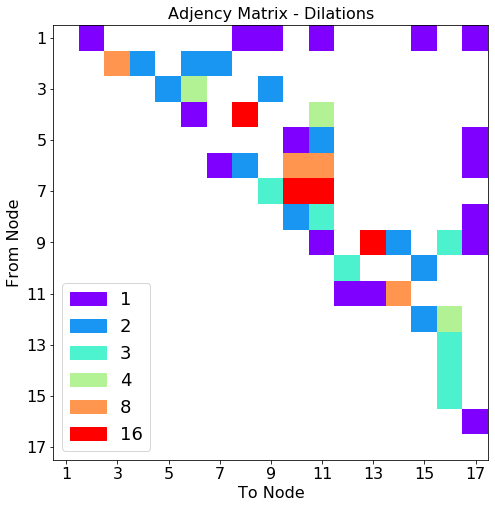

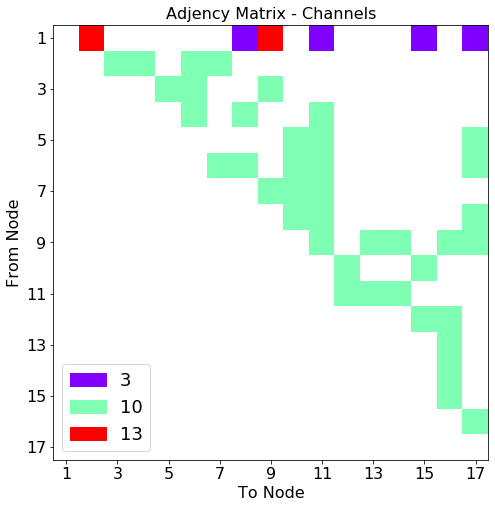

Start training
Total number of refineable parameters:  80312
Epoch 10 of 100 | Learning rate 1.000e-03
   Training Loss: 1.5356e-01 | Validation Loss: 1.8882e-01
   Micro Training F1: 0.9584 | Micro Validation F1: 0.9444
   Macro Training F1: 0.8506 | Macro Validation F1: 0.8037
Epoch 20 of 100 | Learning rate 1.000e-03
   Training Loss: 1.1653e-01 | Validation Loss: 1.5179e-01
   Micro Training F1: 0.9647 | Micro Validation F1: 0.9556
   Macro Training F1: 0.8804 | Macro Validation F1: 0.8404
Epoch 30 of 100 | Learning rate 1.000e-03
   Training Loss: 9.8063e-02 | Validation Loss: 1.4524e-01
   Micro Training F1: 0.9696 | Micro Validation F1: 0.9575
   Macro Training F1: 0.8976 | Macro Validation F1: 0.8513
Epoch 40 of 100 | Learning rate 1.000e-03
   Training Loss: 9.0293e-02 | Validation Loss: 1.4438e-01
   Micro Training F1: 0.9718 | Micro Validation F1: 0.9556
   Macro Training F1: 0.9057 | Macro Validation F1: 0.8518
Epoch 50 of 100 | Learning rate 1.000e-03
   Training Loss: 8.6

In [11]:
for ii in range(N_networks):
    torch.cuda.empty_cache()
    print("Network %i"%(ii+1))
    net = SMSNet.random_SMS_network(in_channels=in_channels,
                                    out_channels=out_channels,
                                    in_shape=(300,300),
                                    out_shape=(300,300),
                                    sizing_settings=sizing_settings,
                                    layers=num_layers,\
                                    dilation_choices=dilation_choices,
                                    hidden_out_channels=hidden_out_channels,
                                    layer_probabilities=layer_probabilities,
                                    network_type=network_type)
    
    # lets plot the network
    net_plot,dil_plot,chan_plot = draw_sparse_network.draw_network(net)
    plt.show()

    nets.append(net)
    
    print("Start training")
    pytorch_total_params = sum(p.numel() for p in net.parameters() if p.requires_grad)
    print("Total number of refineable parameters: ", pytorch_total_params)

    weights = torch.tensor([1.0,2.0]).to('cuda')
    criterion = nn.CrossEntropyLoss(weight=weights)   # For segmenting 
    LEARNING_RATE = 1e-3
    optimizer = optim.Adam(net.parameters(), lr=LEARNING_RATE)
    
    device = helpers.get_device()
    net = net.to(device)
    tmp = train_scripts.train_segmentation(net, 
                                           train_loader, 
                                           test_loader, 
                                           epochs,
                                           criterion, 
                                           optimizer, 
                                           device, 
                                           show=10)
    performance.append(tmp[1]["F1 validation macro"][tmp[1]["Best model index"]])
    net.save_network_parameters("stare_sms_%i.pt"%ii)
    net = net.cpu()
    plots.plot_training_results_segmentation(tmp[1]).show()
    
    # clear out unnecessary variables from device (GPU) memory after each network
    torch.cuda.empty_cache()

## Network evaluation

Select networks based on performance to build a conformal estimator.

In [12]:
sel = np.where(np.array(performance) > 0.78 )[0]
these_nets = []
for ii in sel:
    these_nets.append(nets[ii])
bagged_model = baggins.model_baggin(these_nets,"classification", False)
conf_obj = conformalize_segmentation.build_conformalizer_classify(bagged_model,
                                     test_loader,
                                     alpha=0.10,
                                     missing_label=-1,
                                     device='cuda:0',
                                     norma=True)

### Conformal estimation

In conformal estimation, we need to decide upon a confidence limit alpha. If desired, the parameter alpha can be changed. The lower it gets, the more 'noise' is included in the conformal set. We will set this value at 5% for now, and choose to select all pixels that has a 'vein' classification in their set as a possible 'vein' pixel. 

In [13]:
alpha = 0.10
conf_obj.recalibrate(alpha)
conformal_set = conf_obj(bagged_model(images[0:1]))
possible_veins = conformalize_segmentation.has_label_in_set(conformal_set,1)
mean_p, std_p = bagged_model(images[0:1], 'cuda:0', True)

### View results


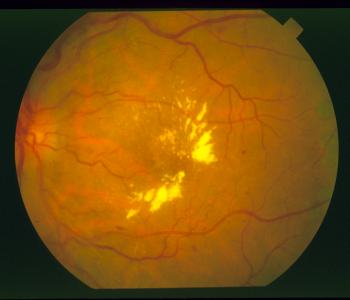


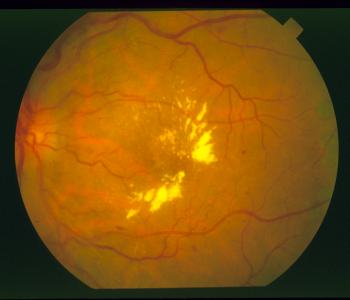


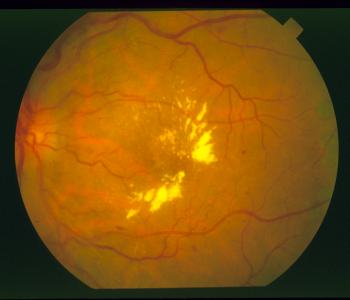


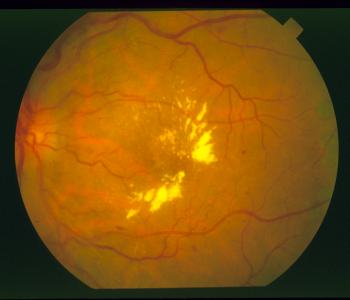

In [14]:
params = {}
params["title"]="Image and Labels - Ground Truth"
img = images[0].permute(1,2,0).numpy()
lbl = labels[0,0].numpy()
fig = plots.plot_rgb_and_labels(img, lbl, params)
fig.update_layout(width=700)
fig.show()

params["title"]="Image and Labels - Estimated labels (conformal alpha = %3.2f )"%alpha
img = images[0].permute(1,2,0).numpy()
lbl = labels[0,0].numpy()
fig = plots.plot_rgb_and_labels(img, possible_veins.numpy()[0], params)
fig.update_layout(width=700)
fig.show()

params["title"]="Image and Class Probability Map"
img = images[0].permute(1,2,0).numpy()
lbl = labels[0,0].numpy()
fig = plots.plot_rgb_and_labels(img, mean_p.numpy()[0,1], params)
fig.update_layout(width=700)
fig.show()

params["title"]="Image and Uncertainty of Estimated labels"
img = images[0].permute(1,2,0).numpy()
lbl = labels[0,0].numpy()
fig = plots.plot_rgb_and_labels(img, std_p.numpy()[0,1], params)
fig.update_layout(width=700)
fig.show()


In [15]:
F1_score_labels = train_scripts.segmentation_metrics(mean_p, labels[0:1,0,...].type(torch.LongTensor))
print( "Micro F1: %5.4f"%F1_score_labels[0].item())
print( "Macro F1: %5.4f"%F1_score_labels[1].item())

Micro F1: 0.9656
Macro F1: 0.8810
